In [1]:
import os, sys
import numpy as np
import rasterio as rio
import boto3 as b3
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
landsat_dl_dir = r'C:\projects\RD\south_africa\landsat\test'

# create the folder if it doesn't exist
if not os.path.exists(landsat_dl_dir):
    os.mkdir(landsat_dl_dir)
    


In [3]:
# use boto3 to download the data
s3_loc = 'earthlab-jmcglinchy/south-africa-landsat'
s3_loc = 'earthlab-jmcglinchy'

s3 = b3.resource('s3')
my_bucket = s3.Bucket(s3_loc)
s3, my_bucket

(s3.ServiceResource(), s3.Bucket(name='earthlab-jmcglinchy'))

In [4]:
dl_objects = []
for object in my_bucket.objects.all():
    if 'south-africa-landsat/L' in object.key:
        print(object)
        dl_objects.append(object)

s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772013040701T1-SC20180911040702.tar.gz')
s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772013052301T1-SC20180911044939.tar.gz')
s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772013060801T1-SC20180911040653.tar.gz')
s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772013062401T1-SC20180911063228.tar.gz')
s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772013072601T1-SC20180911040722.tar.gz')
s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772013082701T1-SC20180911040740.tar.gz')
s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772013111501T1-SC20180911042737.tar.gz')
s3.ObjectSummary(bucket_name='earthlab-jmcglinchy', key='south-africa-landsat/LC081680772014032301T1-SC20180911

In [5]:
sample_obj = dl_objects[0]

# workflow for downloading the object, unzipping, extracting sr_ndvi.tif, and deleting

## first download
# key_base = os.path.basename(sample_obj.key)
# local_key_name = os.path.join(landsat_dl_dir, key_base)
# s3.Bucket(s3_loc).download_file(sample_obj.key, local_key_name)

In [6]:
## use tarfile to get the sr_ndvi.tif file
import tarfile

def sr_tif_files(members):
    for tarinfo in members:
        # if os.path.splitext(tarinfo.name)[1] == ".py":
        #print(tarinfo.name)
        if tarinfo.name.split('.tif')[0].split('_')[-1] == 'ndvi':
            yield tarinfo

# tar = tarfile.open(local_key_name)
# tar.extractall(path=landsat_dl_dir, members=sr_tif_files(tar))
# tar.close()

# # delete local_key_name file (.tar.gz)
# os.remove(local_key_name)


In [7]:
def dl_extract_ndvi_tif(sample_obj, landsat_dl_dir):
    
    key_base = os.path.basename(sample_obj.key)
    local_key_name = os.path.join(landsat_dl_dir, key_base)
    s3.Bucket(s3_loc).download_file(sample_obj.key, local_key_name)

    tar = tarfile.open(local_key_name)
    tar.extractall(path=landsat_dl_dir, members=sr_tif_files(tar))
    tar.close()

    # delete local_key_name file (.tar.gz)
    return os.remove(local_key_name)


# only do this if it hasn't been done
if not os.path.exists(landsat_dl_dir):
    for i,sample_obj in enumerate(dl_objects[1:]):
        print('on file {} of {}'.format(i+1, len(dl_objects) - 1))
        dl_extract_ndvi_tif(sample_obj, landsat_dl_dir)

In [8]:
# extract raster data for an AOI
import geopandas as gpd

shpfile = '../bounding_box/minbound10k_WGS84.shp'
shp = gpd.read_file(shpfile)
bounds = shp['geometry'][0].bounds
bounds


(31.01958199302162,
 -25.068105363674974,
 31.535826264860678,
 -24.63766714051666)

In [9]:
# need to project the geometry to that of the rasters

# create a list of the sr_ndvi.tif files
from glob import glob

tif_dir = '../landsat/test'
tif_list = sorted(glob(tif_dir + "/*.tif"))

with rio.open(tif_list[0]) as src:
    landsat_crs = src.crs

shp_utm = shp.to_crs(landsat_crs)
geom = shp_utm['geometry'][0]


In [10]:
# with the shapefile in UTM, extract the pixels
from rasterio.mask import mask

overlap_list = []
high_overlap_names = []
overlap_t = 0.9 # only record files with overlap of AOI > threshold
for tif in tif_list:
    with rio.open(tif) as src:
        arr, m_tf = mask(src, [geom.__geo_interface__], all_touched=True, crop=True, nodata=-9999)
        arr = np.ma.masked_equal(arr, -9999)
        #print(arr.shape)
        
        m_tf_area = m_tf.a * m_tf.a * arr.count()
        overlap_area = m_tf_area / geom.area
        #print(overlap_area)
        overlap_list.append(overlap_area)
        
        if overlap_area > 0.9:
            high_overlap_names.append(tif)
        
        

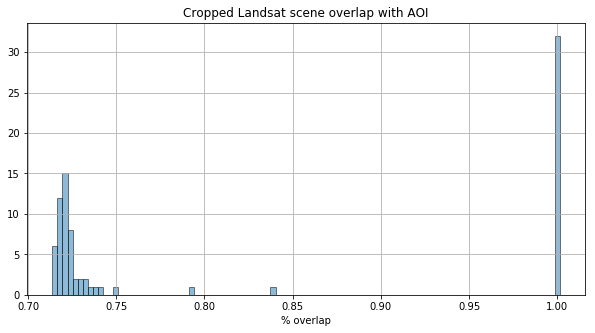

In [11]:
plt.figure(figsize=(10,5))
plt.hist(overlap_list, bins=100, alpha=0.5, edgecolor='k');
plt.title('Cropped Landsat scene overlap with AOI')
plt.xlabel('% overlap')
plt.grid()

In [12]:
os.path.basename(high_overlap_names[0]).split('_')[3]

years = []
months = []
for hon in high_overlap_names:
    acq_date = os.path.basename(hon).split('_')[3]
    year = int(acq_date[:4])
    years.append(year)
    month = int(acq_date[4:6])
    months.append(month)
    
print(set(years))
print(set(months))

{2007, 2008, 2009, 2010, 2011, 2013, 2014}
{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12}


Text(0.5,0,'month')

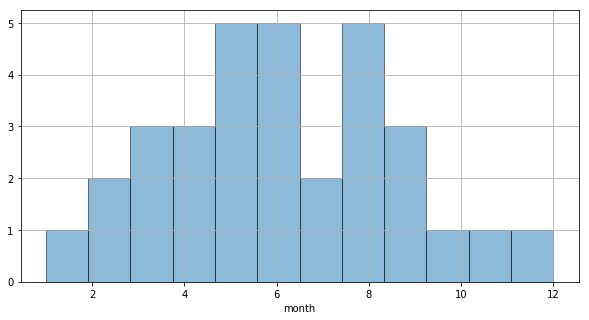

In [13]:
plt.figure(figsize=(10,5))
plt.grid()
plt.hist(months, bins=12, alpha=0.5, edgecolor='k');
plt.title('')
plt.xlabel('month')


2007 {'Jan': 0, 'Feb': 1, 'Mar': 0, 'Apr': 0, 'May': 1, 'Jun': 1, 'Jul': 0, 'Aug': 1, 'Sep': 0, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2008 {'Jan': 0, 'Feb': 1, 'Mar': 0, 'Apr': 1, 'May': 0, 'Jun': 0, 'Jul': 0, 'Aug': 1, 'Sep': 2, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2009 {'Jan': 0, 'Feb': 0, 'Mar': 1, 'Apr': 1, 'May': 1, 'Jun': 0, 'Jul': 0, 'Aug': 0, 'Sep': 0, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2010 {'Jan': 1, 'Feb': 0, 'Mar': 0, 'Apr': 1, 'May': 0, 'Jun': 0, 'Jul': 0, 'Aug': 0, 'Sep': 0, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2011 {'Jan': 0, 'Feb': 0, 'Mar': 1, 'Apr': 0, 'May': 0, 'Jun': 0, 'Jul': 0, 'Aug': 0, 'Sep': 0, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2013 {'Jan': 0, 'Feb': 0, 'Mar': 0, 'Apr': 0, 'May': 1, 'Jun': 2, 'Jul': 1, 'Aug': 1, 'Sep': 0, 'Oct': 0, 'Nov': 1, 'Dec': 0}
2014 {'Jan': 0, 'Feb': 0, 'Mar': 1, 'Apr': 0, 'May': 2, 'Jun': 2, 'Jul': 1, 'Aug': 2, 'Sep': 1, 'Oct': 1, 'Nov': 0, 'Dec': 1}


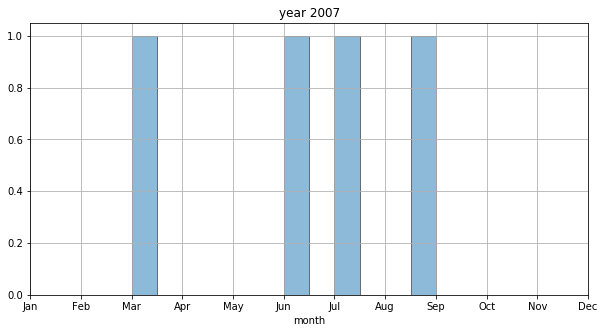

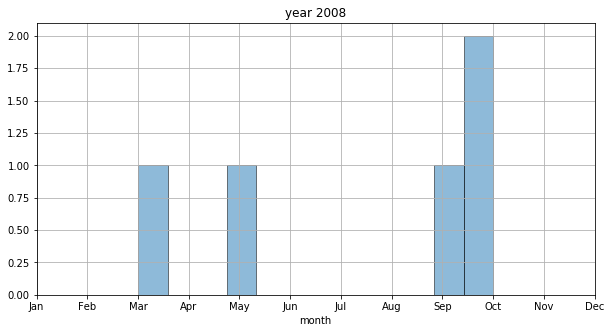

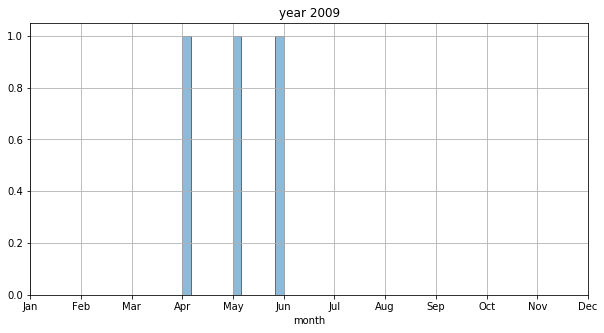

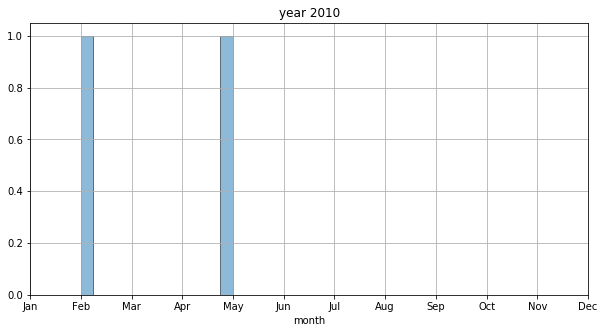

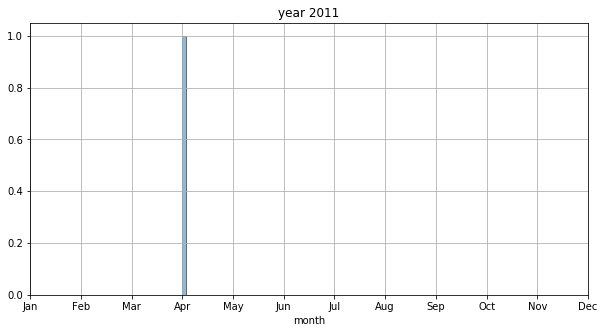

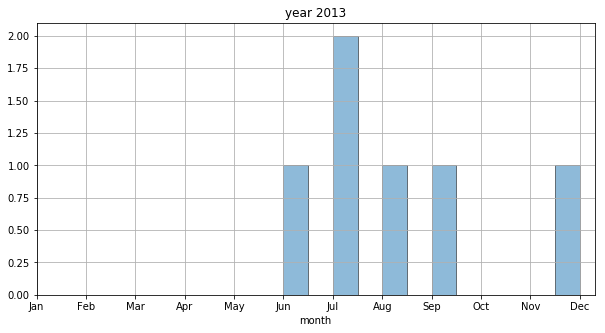

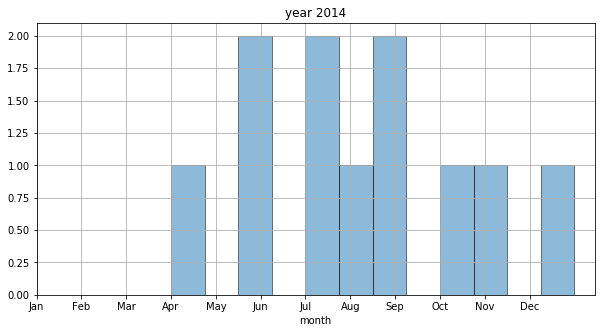

In [14]:
month_labels = ('Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec')
for yr in set(years):
    
    year_months = []
    d = {key: 0 for key in month_labels} # try a dictionary
    
    for hon in high_overlap_names:
        acq_date = os.path.basename(hon).split('_')[3]
        year = int(acq_date[:4])
        if yr == year:
            month = int(acq_date[4:6])
            year_months.append(month)
            
            k = month_labels[month-1]
            d[k] += 1
            
    plt.figure(figsize=(10,5))
    plt.grid()
    plt.hist(year_months, bins=12, alpha=0.5, edgecolor='k');
    
#     hist, bins = np.histogram(year_months, bins=np.arange(1,14))
#     plt.bar(hist, np.arange(1, 13));
    
    plt.xticks(np.arange(12), month_labels)
    plt.title('year {}'.format(yr))
    plt.xlabel('month')
    
    print(yr, d)
    

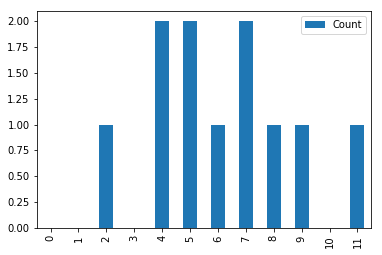

In [15]:
import pandas as pd
pd.DataFrame(list(d.items()), columns=['Month', 'Count']).plot(kind='bar')

## look at all scenes regardless of overlap

{2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014}
{1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12}
2007 {'Jan': 2, 'Feb': 1, 'Mar': 1, 'Apr': 1, 'May': 3, 'Jun': 1, 'Jul': 0, 'Aug': 2, 'Sep': 2, 'Oct': 1, 'Nov': 0, 'Dec': 0}
2008 {'Jan': 0, 'Feb': 2, 'Mar': 0, 'Apr': 2, 'May': 1, 'Jun': 0, 'Jul': 0, 'Aug': 3, 'Sep': 3, 'Oct': 0, 'Nov': 1, 'Dec': 0}
2009 {'Jan': 0, 'Feb': 0, 'Mar': 2, 'Apr': 2, 'May': 1, 'Jun': 0, 'Jul': 0, 'Aug': 0, 'Sep': 0, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2010 {'Jan': 2, 'Feb': 1, 'Mar': 0, 'Apr': 1, 'May': 0, 'Jun': 2, 'Jul': 1, 'Aug': 0, 'Sep': 0, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2011 {'Jan': 0, 'Feb': 0, 'Mar': 1, 'Apr': 1, 'May': 0, 'Jun': 2, 'Jul': 0, 'Aug': 1, 'Sep': 0, 'Oct': 0, 'Nov': 0, 'Dec': 0}
2012 {'Jan': 0, 'Feb': 0, 'Mar': 0, 'Apr': 0, 'May': 1, 'Jun': 0, 'Jul': 2, 'Aug': 1, 'Sep': 1, 'Oct': 1, 'Nov': 1, 'Dec': 0}
2013 {'Jan': 1, 'Feb': 0, 'Mar': 0, 'Apr': 2, 'May': 3, 'Jun': 2, 'Jul': 1, 'Aug': 1, 'Sep': 1, 'Oct': 1, 'Nov': 1, 'Dec': 1}
2014 {'Jan': 1, 'Feb': 1, 'Ma

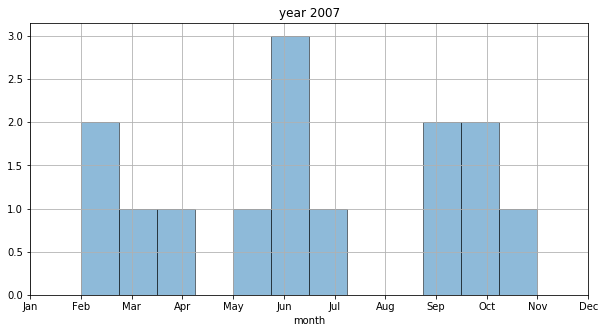

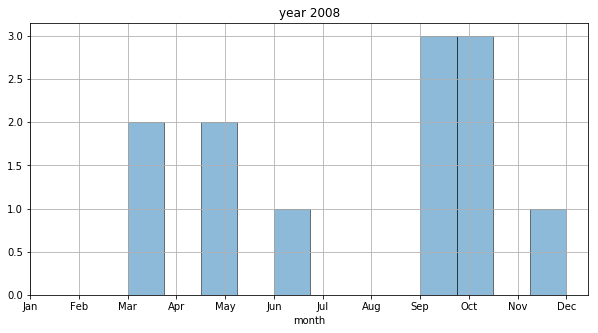

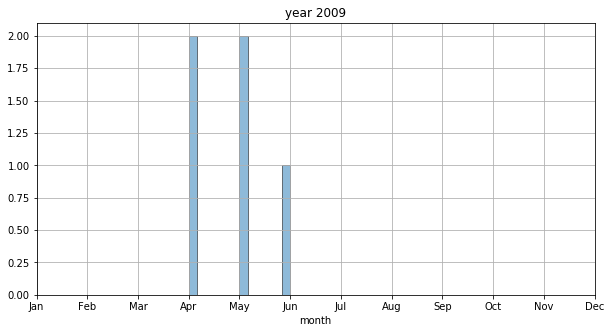

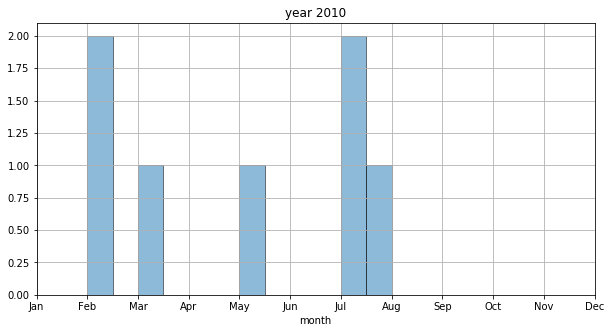

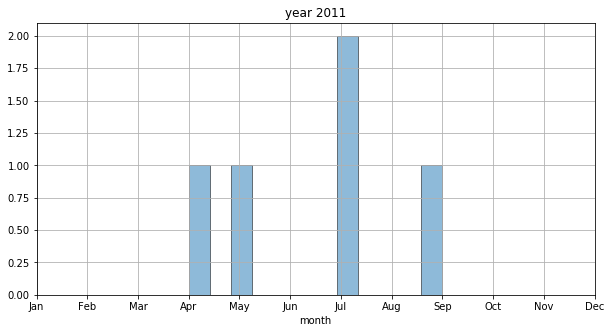

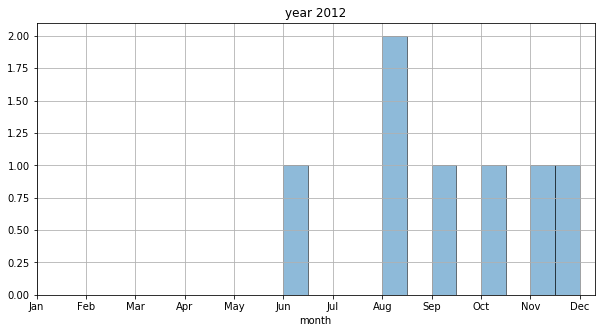

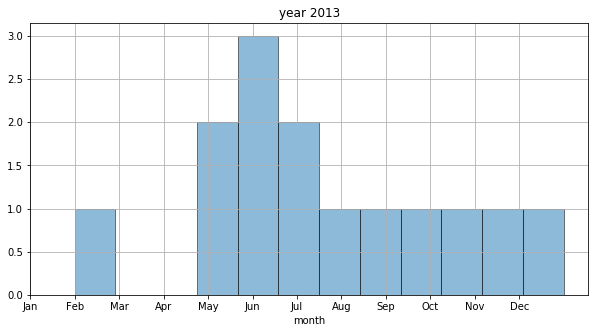

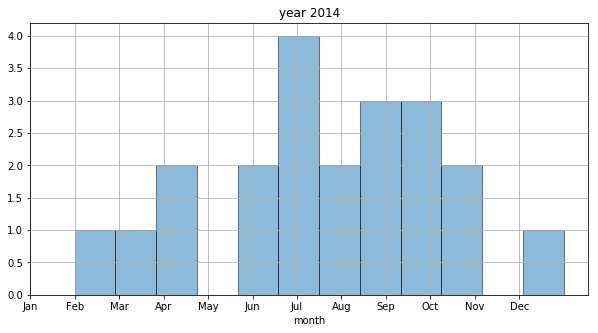

In [16]:
overlap_list = []
high_overlap_names = []
overlap_t = 0.5 # only record files with overlap of AOI > threshold
for tif in tif_list:
    with rio.open(tif) as src:
        arr, m_tf = mask(src, [geom.__geo_interface__], all_touched=True, crop=True, nodata=-9999)
        arr = np.ma.masked_equal(arr, -9999)
        #print(arr.shape)
        
        m_tf_area = m_tf.a * m_tf.a * arr.count()
        overlap_area = m_tf_area / geom.area
        #print(overlap_area)
        overlap_list.append(overlap_area)
        
        if overlap_area > overlap_t:
            high_overlap_names.append(tif)

years = []
months = []
for hon in high_overlap_names:
    acq_date = os.path.basename(hon).split('_')[3]
    year = int(acq_date[:4])
    years.append(year)
    month = int(acq_date[4:6])
    months.append(month)
    
print(set(years))
print(set(months))

month_labels = ('Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec')
for yr in set(years):
    
    year_months = []
    d = {key: 0 for key in month_labels} # try a dictionary
    
    for hon in high_overlap_names:
        acq_date = os.path.basename(hon).split('_')[3]
        year = int(acq_date[:4])
        if yr == year:
            month = int(acq_date[4:6])
            year_months.append(month)
            
            k = month_labels[month-1]
            d[k] += 1
            
    plt.figure(figsize=(10,5))
    plt.grid()
    plt.hist(year_months, bins=12, alpha=0.5, edgecolor='k');
    
#     hist, bins = np.histogram(year_months, bins=np.arange(1,14))
#     plt.bar(hist, np.arange(1, 13));
    
    plt.xticks(np.arange(12), month_labels)
    plt.title('year {}'.format(yr))
    plt.xlabel('month')
    
    print(yr, d)

## View the masked images


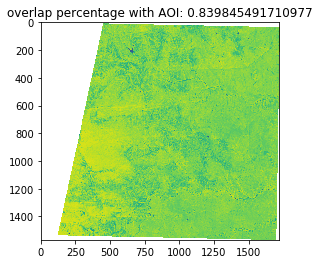

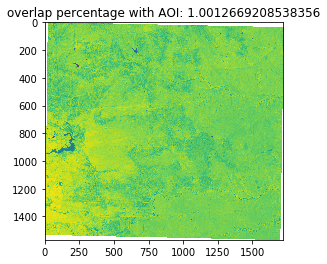

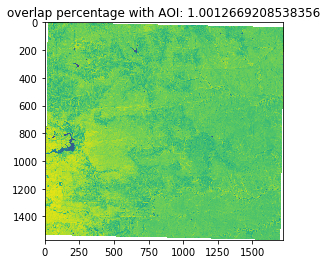

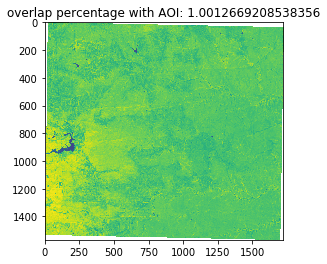

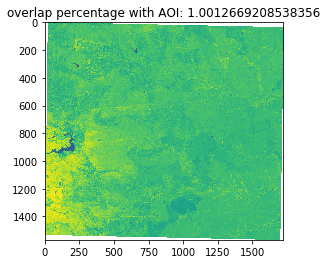

...

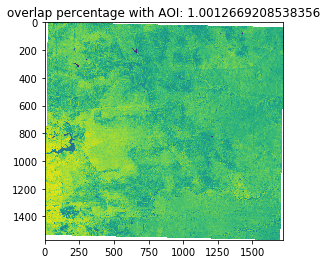

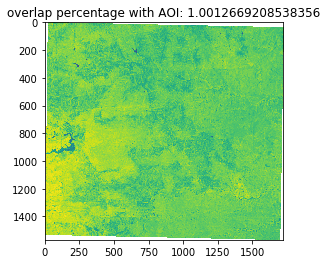

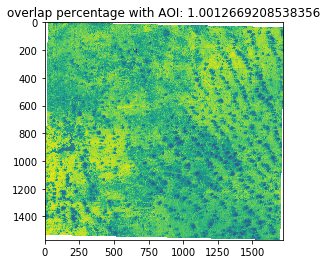

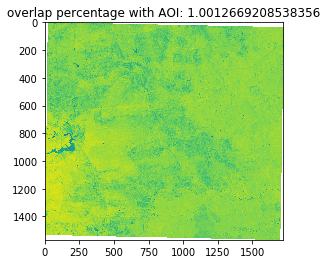

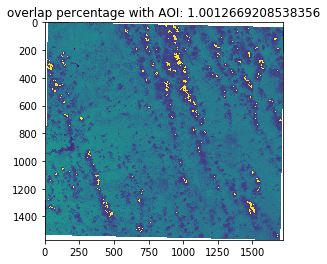

In [19]:
for tif in tif_list:
    with rio.open(tif) as src:
        arr, m_tf = mask(src, [geom.__geo_interface__], all_touched=True, crop=True, nodata=-9999)
        arr = np.ma.masked_equal(arr, -9999)
        #print(arr.shape)
        
        m_tf_area = m_tf.a * m_tf.a * arr.count()
        overlap_area = m_tf_area / geom.area
        
        plt.imshow(arr[0])
        plt.title('overlap percentage with AOI: {}'.format(overlap_area))
        plt.show()

In [18]:
tif_list

['../landsat/test\\LC08_L1TP_168077_20130407_20170505_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20130523_20180526_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20130608_20170504_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20130624_20170504_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20130726_20170503_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20130827_20170502_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20131115_20170428_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20140323_20170425_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20140510_20170422_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20140526_20170422_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20140611_20170422_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20140627_20170421_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20140713_20170421_01_T1_sr_ndvi.tif',
 '../landsat/test\\LC08_L1TP_168077_20

In [21]:
## sort by date collected
acqnum = [int(os.path.basename(tif).split('_')[3]) for tif in tif_list]


In [28]:
#help(np.argsort)
sort_acqnum = list(np.argsort(acqnum))

In [32]:
tif_list_sorted = [tif_list[i] for i in sort_acqnum]

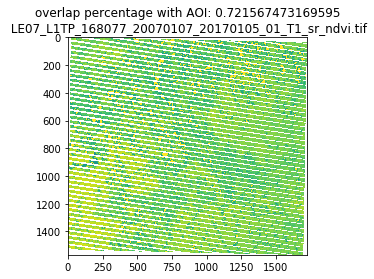

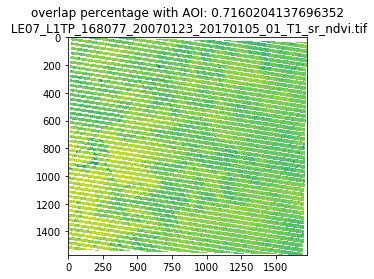

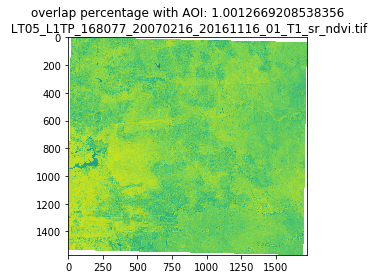

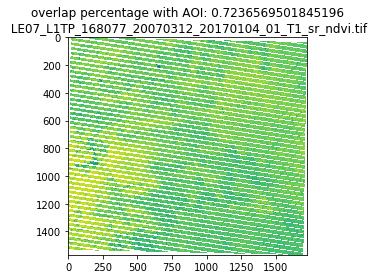

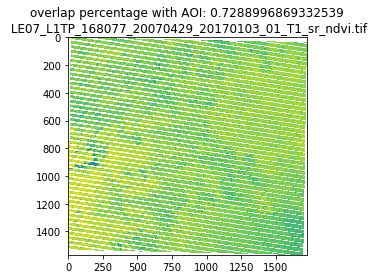

...

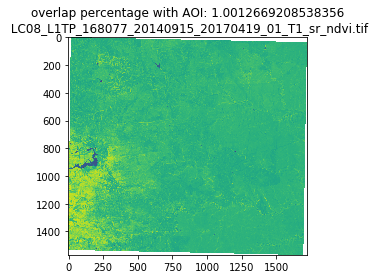

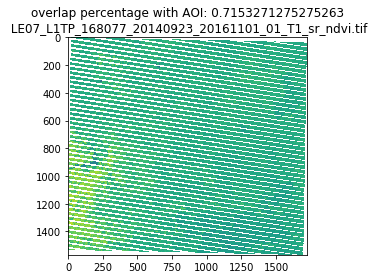

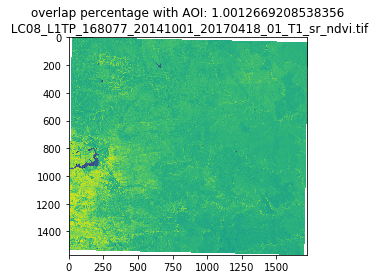

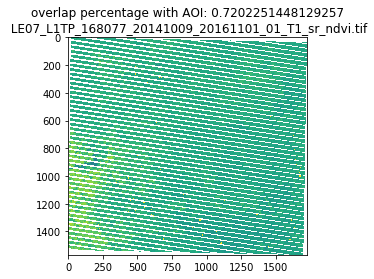

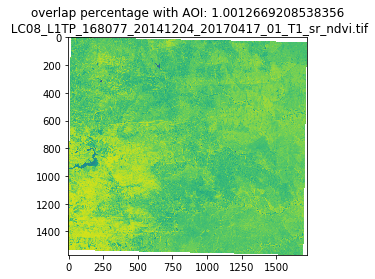

In [36]:
for tif in tif_list_sorted:
    with rio.open(tif) as src:
        arr, m_tf = mask(src, [geom.__geo_interface__], all_touched=True, crop=True, nodata=-9999)
        arr = np.ma.masked_equal(arr, -9999)
        #print(arr.shape)
        
        m_tf_area = m_tf.a * m_tf.a * arr.count()
        overlap_area = m_tf_area / geom.area
        
        plt.imshow(arr[0]/10000, vmin=-1., vmax=1.0)
        plt.title('overlap percentage with AOI: {}\n {}'.format(overlap_area, os.path.basename(tif)))
        plt.show()